## Exploratory Data Analysis (EDA)

In this section, we will focus on data and conduct an exploratory data analysis (EDA). Our goal is to gain more information about the data, enabling us to be better prepared for generating insights. As we already know, we have two datasets: the positive and the negative one. The positive dataset consists of audios with screams, while the negative dataset contains voice samples without screams. The negative audios provide various non-screaming vocal sounds to help improve scream detection accuracy, such as people talking, nature sounds, and music. Conducting EDA for a scream detection project with preprocessed audio data (converted to spectrograms and MFCCs) involves visualizing the data, analyzing distributions and correlations, and checking for class imbalances. This will help us understand the characteristics and distributions of our data, setting a strong foundation for further analysis and model development.


#### Importing Libraries


In [ ]:
#Installing the needed libraries
!pip install librosa tensorflow matplotlib


In [ ]:
import os
import librosa
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


###  All the Functions of this project

In [ ]:
screaming_file_path = '/content/drive/My Drive/DeepLearning/code/dataset/Screaming'
notScreaming_file_path = '/content/drive/My Drive/DeepLearning/code/dataset/NotScreaming'

### Load the data

In [ ]:
import os
import numpy as np
import librosa

def load_audio_files(folder_path, label):
    audio_files = []
    durations = []
    amplitudes = []
    sample_rates = []
    zcr = []
    mfcc = []
    chroma = []
    mel_spectrogram = []
    spectral_centroid = []
    spectral_bandwidth = []
    spectral_rolloff = []
    spectral_flux = []
    spectral_contrast = []
    spectral_flatness = []
    rms = []
    energy = []
    labels = []
    for file_name in os.listdir(folder_path):
        if file_name.endswith('.wav'):
            file_path = os.path.join(folder_path, file_name)
            y, sr = librosa.load(file_path, sr=None)
            audio_files.append(y)
            durations.append(librosa.get_duration(y=y, sr=sr))
            amplitudes.append(np.max(np.abs(y)))
            sample_rates.append(sr)
            zcr.append(np.mean(librosa.feature.zero_crossing_rate(y)))
            mfcc_features = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)
            mfcc.append(np.mean(mfcc_features, axis=1))
            chroma_features = librosa.feature.chroma_stft(y=y, sr=sr, n_chroma=12)
            chroma.append(np.mean(chroma_features, axis=1))
            mel_spectrogram_features = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=40)  # Higher resolution example
            mel_spectrogram.append(np.mean(mel_spectrogram_features, axis=1))
            spectral_centroid.append(np.mean(librosa.feature.spectral_centroid(y=y, sr=sr)))
            spectral_bandwidth.append(np.mean(librosa.feature.spectral_bandwidth(y=y, sr=sr)))
            spectral_rolloff.append(np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr)))
            spectral_flux.append(np.mean(librosa.onset.onset_strength(y=y, sr=sr)))
            spectral_contrast.append(np.mean(librosa.feature.spectral_contrast(y=y, sr=sr)))
            spectral_flatness.append(np.mean(librosa.feature.spectral_flatness(y=y)))
            rms.append(np.mean(librosa.feature.rms(y=y)))
            energy.append(np.sum(y**2))
            labels.append(label)
    return audio_files, durations, amplitudes, sample_rates, zcr, mfcc, chroma, mel_spectrogram, spectral_centroid, spectral_bandwidth, spectral_rolloff, spectral_flux, spectral_contrast, spectral_flatness, rms, energy, labels

# Load audio files from both folders
screaming_files, screaming_durations, screaming_amplitudes, screaming_sample_rates, screaming_zcr, screaming_mfcc, screaming_chroma, screaming_mel_spectrogram, screaming_spectral_centroid, screaming_spectral_bandwidth, screaming_spectral_rolloff, screaming_spectral_flux, screaming_spectral_contrast, screaming_spectral_flatness, screaming_rms, screaming_energy, screaming_labels = load_audio_files(screaming_file_path, 1)
notscreaming_files, notscreaming_durations, notscreaming_amplitudes, notscreaming_sample_rates, notscreaming_zcr, notscreaming_mfcc, notscreaming_chroma, notscreaming_mel_spectrogram, notscreaming_spectral_centroid, notscreaming_spectral_bandwidth, notscreaming_spectral_rolloff, notscreaming_spectral_flux, notscreaming_spectral_contrast, notscreaming_spectral_flatness, notscreaming_rms, notscreaming_energy, notscreaming_labels = load_audio_files(notScreaming_file_path, 0)

KeyboardInterrupt: 

In [ ]:
screaming_df = pd.DataFrame({
    'File': [file_name for file_name in os.listdir(screaming_file_path) if file_name.endswith('.wav')],
    'Label': screaming_labels,
    'Duration': screaming_durations,
    'Max Amplitude': screaming_amplitudes,
    'Sample Rate': screaming_sample_rates,
    'ZCR' : screaming_zcr,
    'MFCC' : screaming_mfcc,
    'Chroma' : screaming_chroma,
    'Mel Spectrogram' : screaming_mel_spectrogram,
    'Spectral Centroid' : screaming_spectral_centroid,
    'Spectral Bandwidth' : screaming_spectral_bandwidth,
    'Spectral Rolloff' : screaming_spectral_rolloff,
    'Spectral Flux' : screaming_spectral_flux,
    'Spectral Contrast' : screaming_spectral_contrast,
    'Spectral Flatness' : screaming_spectral_flatness,
    'RMS' : screaming_rms,
    'Energy' : screaming_energy
})

# Create DataFrame for not screaming data
notscreaming_df = pd.DataFrame({
    'File': [file_name for file_name in os.listdir(notScreaming_file_path) if file_name.endswith('.wav')],
    'Label': notscreaming_labels,
    'Duration': notscreaming_durations,
    'Max Amplitude': notscreaming_amplitudes,
    'Sample Rate': notscreaming_sample_rates,
    'ZCR' : notscreaming_zcr,
    'MFCC' : notscreaming_mfcc,
    'Chroma' : notscreaming_chroma,
    'Mel Spectrogram' : notscreaming_mel_spectrogram,
    'Spectral Centroid' : notscreaming_spectral_centroid,
    'Spectral Bandwidth' : notscreaming_spectral_bandwidth,
    'Spectral Rolloff' : notscreaming_spectral_rolloff,
    'Spectral Flux' : notscreaming_spectral_flux,
    'Spectral Contrast' : notscreaming_spectral_contrast,
    'Spectral Flatness' : notscreaming_spectral_flatness,
    'RMS' : notscreaming_rms,
    'Energy' : notscreaming_energy
})

audio_data_df = pd.concat([screaming_df, notscreaming_df], ignore_index=True)

csv_path = '/content/drive/My Drive/DeepLearning/code/dataset/audio_data_raw.csv'
audio_data_df.to_csv(csv_path, index=False)
audio_data_df = pd.read_csv(csv_path)

#### Overview of audio features

1. #### Waveform:
The audio signal can be visualized as a waveform, where the amplitude is plotted over time. The peaks and troughs of this waveform represent the changes in air pressure (or signal level) over time.

2. #### Max Amplitude:
Refers to the highest absolute value of the amplitude in a given audio signal. In the context of digital audio processing, the amplitude represents the strength or level of the audio signal at any given point in time. Amplitude is directly related to the perceived loudness of the sound. Higher amplitudes correspond to louder sounds.

3. #### Zero Crossing Rate (ZCR)
The Zero Crossing Rate is the rate at which the signal changes sign from positive to negative or vice versa. It is a simple feature often used in audio processing to detect the presence of noise or voiced/unvoiced parts of a signal.

4. #### Spectral Centroid
The Spectral Centroid indicates where the center of mass of the spectrum is located. It is often associated with the perceived brightness of a sound. The higher the spectral centroid, the brighter or more trebly the sound.

5. #### Spectral Bandwidth
Spectral Bandwidth measures the width of the spectrum. Specifically, it represents the difference between the upper and lower frequencies in a spectrum. It gives an idea of the range of frequencies present in the signal.

6. ### Spectral Contrast
Spectral Contrast is the difference in amplitude between peaks and valleys in a sound spectrum. This feature can be used to characterize the timbre of a sound, distinguishing between, for example, harmonic and percussive sounds.

7. ### Spectral Flatness
Spectral Flatness is a measure of how flat or peaky the spectrum is. A high spectral flatness value indicates that the spectrum is relatively flat (like white noise), while a low value indicates a peaky spectrum (like a pure tone).

8. ### RMS Energy
RMS Energy (Root Mean Square Energy) measures the magnitude of the audio signal. It provides a good estimate of the power or loudness of the signal.

9. ### Chroma STFT
Chroma STFT (Short-Time Fourier Transform) represents the energy distribution of the signal over the twelve different pitch classes (the twelve semitones of the musical octave). This feature is useful for analyzing harmonic and tonal content.

10. ### Tempo
Tempo refers to the speed or pace of a piece of music, usually measured in beats per minute (BPM). It is a critical feature in music analysis, indicating how fast or slow a piece of music is.  what title can i put in jupiter for this


In [ ]:
print(audio_data_df.head())

                  File  Label  Duration  Max Amplitude  Sample Rate       ZCR  \
0  ---1_cCGK4M_out.wav      1      10.0       0.728760        44100  0.059231   
1  0JOdbnmi_Og_out.wav      1      10.0       0.690460        44100  0.074159   
2  -2yygHLdpXc_out.wav      1      10.0       0.998123        44100  0.106283   
3  -20uudT97E0_out.wav      1      10.0       0.790237        44100  0.044368   
4  0-RnTXpp8Q0_out.wav      1      10.0       0.465820        44100  0.050893   

                                                MFCC  \
0  [-128.8204      153.94453     -44.551456     4...   
1  [-225.33205    135.51776    -58.501278     9.9...   
2  [-226.98717    101.09908   -146.91959    -21.1...   
3  [-202.97813     187.05995     -42.500618     1...   
4  [-417.2208     135.55249     -8.679534     3.2...   

                                              Chroma  \
0  [0.5896564  0.58744466 0.60435575 0.63065773 0...   
1  [0.30595174 0.3171385  0.3601824  0.4003121  0...   
2  [0.07

In [ ]:
print(audio_data_df.tail())

                     File  Label  Duration  Max Amplitude  Sample Rate  \
3488  CelxGPZvoyw_out.wav      0      10.0       1.000000        44100   
3489  CcXfe1xEuhA_out.wav      0      10.0       0.405792        44100   
3490  CYn0BPhowYs_out.wav      0      10.0       0.556458        44100   
3491  COe52lCaNPk_out.wav      0      10.0       0.996201        44100   
3492  CKO35LsM0XI_out.wav      0      10.0       0.799927        44100   

           ZCR                                               MFCC  \
3488  0.198724  [-5.0177386e+02  2.9860613e+01 -5.3262062e+01 ...   
3489  0.091808  [-2.1270705e+02  1.3728484e+02 -8.6514046e+01 ...   
3490  0.037940  [-323.57675    194.51004    -29.54443     16.2...   
3491  0.047116  [-227.2744     196.6444     -37.090233    -1.4...   
3492  0.078528  [-1.4561522e+02  1.3669267e+02 -4.5439629e+01 ...   

                                                 Chroma  \
3488  [0.4686062  0.47409695 0.54258525 0.596501   0...   
3489  [0.40072802 0.46

In [ ]:
audio_data_df.shape

(3493, 17)

In [ ]:
audio_data_df.dtypes

File                   object
Label                   int64
Duration              float64
Max Amplitude         float64
Sample Rate             int64
ZCR                   float64
MFCC                   object
Chroma                 object
Mel Spectrogram        object
Spectral Centroid     float64
Spectral Bandwidth    float64
Spectral Rolloff      float64
Spectral Flux         float64
Spectral Contrast     float64
Spectral Flatness     float64
RMS                   float64
Energy                float64
dtype: object

In [ ]:
label_counts = audio_data_df["Label"].value_counts(ascending=True)
print(label_counts)

Label
1     862
0    2631
Name: count, dtype: int64


It is evident that the classes are imbalanced.

In [ ]:
print(audio_data_df.nunique())

File                  3493
Label                    2
Duration               294
Max Amplitude         2584
Sample Rate              1
ZCR                   3471
MFCC                  3493
Chroma                3493
Mel Spectrogram       3493
Spectral Centroid     3493
Spectral Bandwidth    3493
Spectral Rolloff      3474
Spectral Flux         3491
Spectral Contrast     3493
Spectral Flatness     3493
RMS                   3492
Energy                3493
dtype: int64


Here we can observe that the sample rate is consistent across all audio files, with each recording having a sample rate of 44100Hz.

In [ ]:
# Display summary statistics for the numerical columns in the DataFrame
audio_data_df.describe()

,Label,Duration,Max Amplitude,Sample Rate,ZCR,Spectral Centroid,Spectral Bandwidth,Spectral Rolloff,Spectral Flux,Spectral Contrast,Spectral Flatness,RMS,Energy
count,3493.000000,3493.000000,3493.000000,3493.0,3493.000000,3493.000000,3493.000000,3493.000000,3493.000000,3493.000000,3.493000e+03,3493.000000,3493.000000
mean,0.246779,9.853476,0.703599,44100.0,0.074838,2631.604447,2629.360880,5054.074940,1.095468,18.549661,1.801934e-02,0.108040,11610.167495
std,0.431199,0.783854,0.287964,0.0,0.047133,1193.936805,949.422010,2409.668265,0.235262,2.059871,7.219662e-02,0.095192,20610.928165
min,0.000000,0.510862,0.007965,44100.0,0.000106,134.643463,298.571903,139.091502,0.068724,10.055640,8.239362e-07,0.000269,0.064466
25%,0.000000,10.000000,0.479599,44100.0,0.045274,1794.141860,1913.701214,3299.701084,0.965796,17.231130,1.131653e-04,0.039205,1227.441300
50%,0.000000,10.000000,0.763443,44100.0,0.065404,2467.778802,2616.049391,4706.653597,1.092975,18.489509,7.856378e-04,0.082401,4740.416000
75%,0.000000,10.000000,0.998886,44100.0,0.090585,3242.270860,3244.770419,6458.487087,1.220560,19.842825,5.433550e-03,0.149076,13228.280000
max,1.000000,10.000000,1.000000,44100.0,0.538355,10931.814879,6065.407335,15575.900092,3.625394,29.419078,8.618782e-01,0.771921,271525.120000


In [ ]:
missing_values = audio_data_df.isnull().sum()
print(missing_values)

File                  0
Label                 0
Duration              0
Max Amplitude         0
Sample Rate           0
ZCR                   0
MFCC                  0
Chroma                0
Mel Spectrogram       0
Spectral Centroid     0
Spectral Bandwidth    0
Spectral Rolloff      0
Spectral Flux         0
Spectral Contrast     0
Spectral Flatness     0
RMS                   0
Energy                0
dtype: int64


In [ ]:

import random
from IPython.display import Audio

def view_random_sample(audio_data_df, folder_path):
    # Get a random index
    random_index = random.choice(audio_data_df.index)

    # Get the file path of the audio sample at the random index
    file_name = audio_data_df.loc[random_index, 'File']
    file_path = os.path.join(folder_path, file_name)

    # Load the audio sample
    audio, sr = librosa.load(file_path, sr=None)

    # Display the audio sample
    display(Audio(data=audio, rate=sr))


In [ ]:
audio_data_df.sample(10)

,File,Label,Duration,Max Amplitude,Sample Rate,ZCR,MFCC,Chroma,Mel Spectrogram,Spectral Centroid,Spectral Bandwidth,Spectral Rolloff,Spectral Flux,Spectral Contrast,Spectral Flatness,RMS,Energy
473,UJEZK5o_L5Q_out.wav,1,10.000000,0.723694,44100,0.074147,[-4.1777988e+02 7.5910492e+01 -7.0012474e+00 ...,[0.38982588 0.30904722 0.31632116 0.28837115 0...,[7.44967314e-04 3.05189118e-02 1.82912096e-01 ...,2939.861998,3045.405621,5990.352254,0.996703,17.468851,0.008960,0.033654,4092.72530
1779,xVi1wNljxjk_out.wav,0,10.000000,0.407837,44100,0.049350,[-188.25467 123.87133 -13.938959 3...,[0.26530093 0.20435849 0.24825987 0.50639576 0...,[4.69281120e+01 4.02461472e+01 1.39761295e+01 ...,3048.985588,4053.419370,7280.970513,1.090788,20.842588,0.001294,0.089456,3895.66280
1027,d9r_kYpOvW8_out.wav,0,10.000000,0.726227,44100,0.056515,[-3.2417850e+02 1.3534114e+02 7.3314929e+00 ...,[0.27879444 0.25251436 0.33546436 0.2757344 0...,[5.34592308e-02 1.16969116e-01 8.53067696e-01 ...,2181.431921,2778.197043,3637.112887,1.066023,19.957890,0.003045,0.096580,5585.52050
1547,q_rPTSzG_xE_out.wav,0,10.000000,1.000000,44100,0.031770,[-3.0750195e+02 1.1127532e+02 2.7859981e+00 ...,[0.0804761 0.02304439 0.10613913 0.21990933 0...,[7.59438127e-02 7.01564252e-02 4.80009988e-02 ...,1702.168446,3011.247583,1711.165214,0.836552,20.613235,0.004213,0.231223,31621.56800
84,3zAp2kxzU7Q_out.wav,1,10.000000,0.700897,44100,0.070945,[-234.08054 150.86345 -45.26161 2...,[0.39606366 0.4036123 0.41307658 0.35277206 0...,[8.86306667e+00 1.12412281e+01 4.61782694e+00 ...,2603.814042,2741.950081,5118.657215,1.172767,17.544342,0.001426,0.059391,2155.76460
1031,dT7uHHQEYHQ_out.wav,0,10.000000,0.969604,44100,0.116884,[-109.10956 141.24736 -77.788826 8...,[0.42395654 0.45324016 0.48308736 0.5789153 0...,[7.44998407e+00 3.95793228e+01 4.93958588e+01 ...,3787.708052,3148.869508,7578.738240,1.154527,19.682072,0.000112,0.171666,15148.66800
324,I3tsPWybQRI_out.wav,1,10.000000,1.000000,44100,0.117756,[ -6.351737 99.27008 -41.966675 27.72...,[0.36816987 0.36660826 0.35349098 0.3691273 0...,[1.85555305e+01 1.63453655e+01 2.70892487e+01 ...,4449.540504,3920.255217,9155.683152,1.363601,16.567073,0.010841,0.482328,142538.62000
2091,HdGE3gaIf4w_out.wav,0,9.072925,0.279907,44100,0.077158,[-400.53317 124.16614 -31.663078 -9.4...,[0.34641716 0.25524142 0.21875127 0.27191857 0...,[4.3891083e-05 8.3485196e-05 2.9282787e-04 4.0...,3182.780318,3699.018283,6376.664340,1.111952,18.354800,0.005192,0.010400,89.01395
2618,Ufw0P-xOrng_out.wav,0,10.000000,1.000000,44100,0.068023,[-2.6332034e+02 1.1245950e+02 7.5102949e+00 ...,[0.6158228 0.5965858 0.5922632 0.59107846 0...,[1.53906527e+01 1.62368813e+01 4.97471380e+00 ...,3457.125470,3898.662258,7118.971879,1.617733,17.021345,0.011158,0.055109,2007.91540
1299,kaI31euhEYE_out.wav,0,10.000000,0.722855,44100,0.186012,[-364.5753 80.0398 -55.254078 4...,[0.40880597 0.34778064 0.3534409 0.3890529 0...,[3.9286897e-04 7.9031708e-04 2.2466651e-03 2.5...,4522.849316,3079.323428,7505.370471,1.070316,18.058841,0.005577,0.023466,765.09045


In [ ]:
from IPython.display import Audio, display
import os
import librosa

def play_audio(file_path):
    if os.path.exists(file_path) and file_path.endswith('.wav'):
        y, sr = librosa.load(file_path, sr=None)
        display(Audio(data=y, rate=sr))
    else:
        print("The specified file does not exist or is not a .wav file.")



In [ ]:
print('Listen to the audio files in the Screaming folder.')
play_audio('/content/drive/My Drive/DeepLearning/code/dataset/Screaming/0-RnTXpp8Q0_out.wav'), play_audio('/content/drive/My Drive/DeepLearning/code/dataset/Screaming/lbLFYOSNbGQ_out.wav')

Listen to the audio files in the Screaming folder.


(None, None)

In [ ]:
print('Listen to the audio files in the NotScreaming folder.')
play_audio('/content/drive/My Drive/DeepLearning/code/dataset/NotScreaming/MGvjQbBNEE0_out.wav'), play_audio('/content/drive/My Drive/DeepLearning/code/dataset/NotScreaming/B9sno0As9PY_out.wav')

Listen to the audio files in the NotScreaming folder.


(None, None)

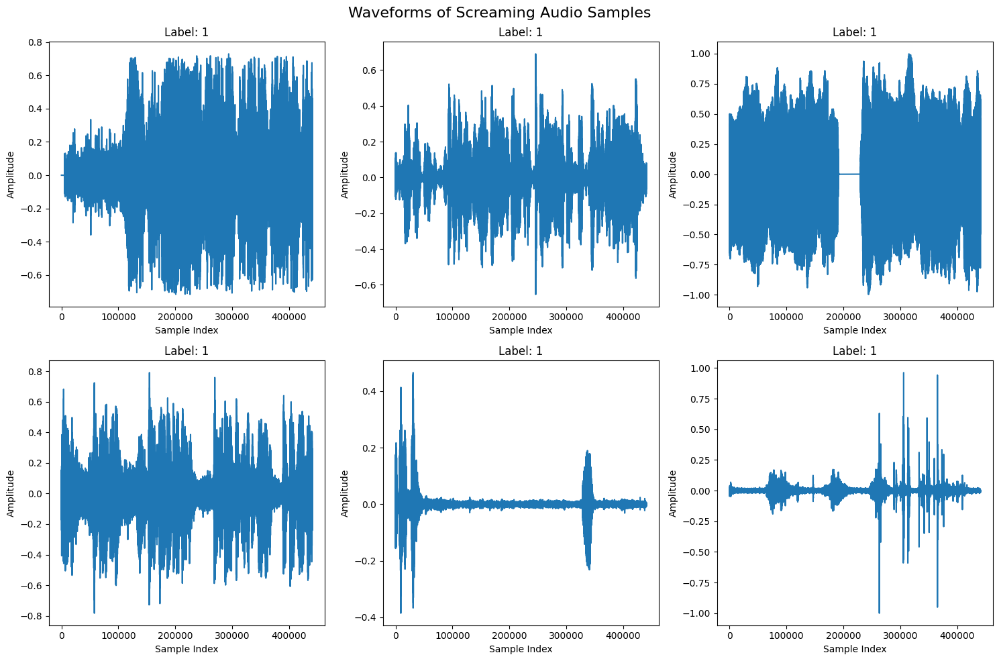

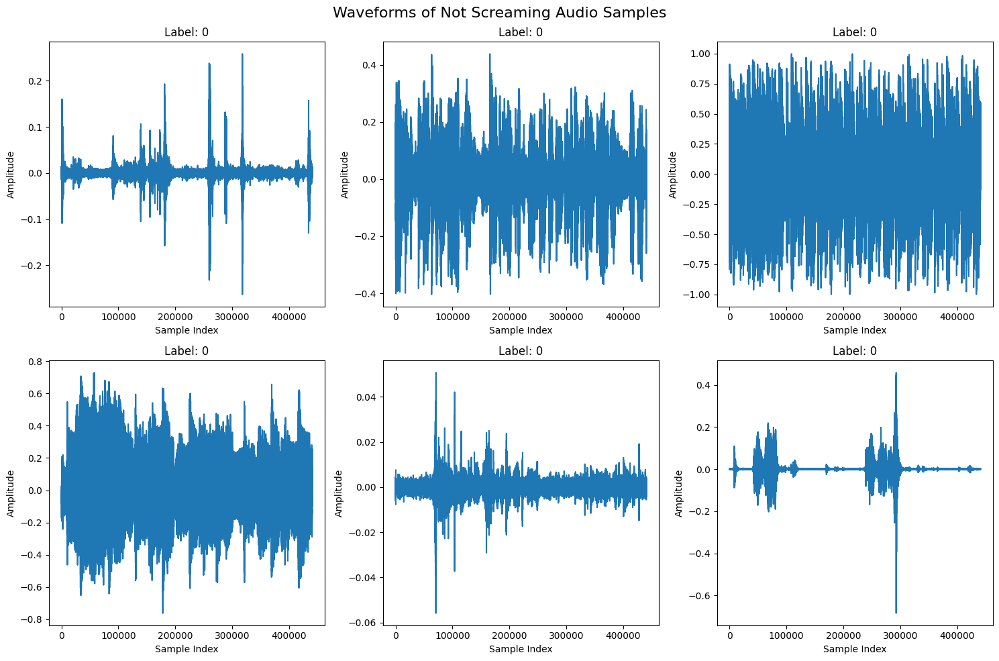

In [ ]:
def plot_waveforms(audio_files, labels, title, num_samples=6):
    num_rows = (num_samples + 2) // 3  # Calculate the number of rows needed
    fig, axes = plt.subplots(num_rows, 3, figsize=(15, 5*num_rows))
    fig.suptitle(title, fontsize=16)
    for i, ax in enumerate(axes.flat):
        if i < num_samples:
            ax.plot(audio_files[i])
            ax.set_title(f'Label: {labels[i]}')
            ax.set_xlabel('Sample Index')
            ax.set_ylabel('Amplitude')
        else:
            ax.axis('off')  # Hide empty subplot
    plt.tight_layout()
    plt.show()

plot_waveforms(screaming_files[:6], screaming_labels[:6], 'Waveforms of Screaming Audio Samples')
plot_waveforms(notscreaming_files[:6], notscreaming_labels[:6], 'Waveforms of Not Screaming Audio Samples')



###  Null Data in Audio
There are many ways to treat null audio data in the time domain. However, the following approach often is the simplest. Given the signal and a minimum threshold for the amplitude of the signal:

Take the absolute value of each point in the signal
If the point is greater than the threshold, we keep it. Otherwise, we remove it.  translate to greek

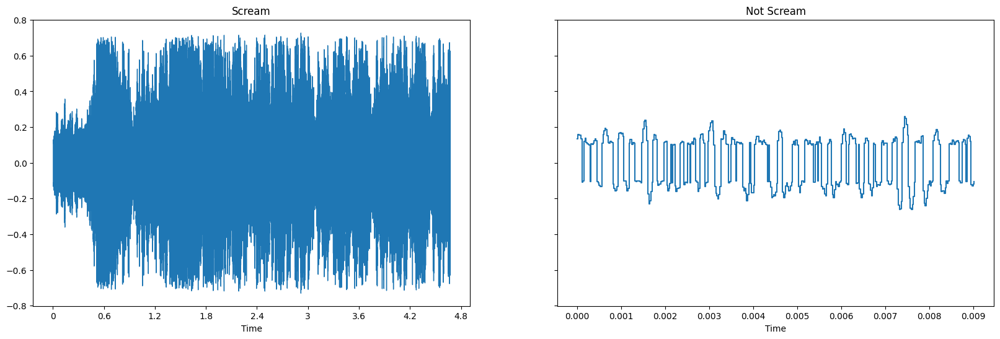

In [ ]:
import librosa.display as lds

def env_mask(wav, threshold):
    wav = np.abs(wav)  # Take the absolute value
    mask = wav > threshold  # Apply the threshold
    return mask

screaming_mask = env_mask(screaming_files[0], 0.1)
not_screaming_mask = env_mask(notscreaming_files[0], 0.1)

fig, ax = plt.subplots(1, 2, figsize=(20, 6), sharey=True)

ax[0].set(title='Scream')
lds.waveshow(screaming_files[0][screaming_mask], sr=screaming_sample_rates[0], ax=ax[0])
ax[1].set(title='Not Scream')
lds.waveshow(notscreaming_files[0][not_screaming_mask], sr=notscreaming_sample_rates[0], ax=ax[1])

plt.show()


### Amplitude Envelope

The Amplitude Envelope (AE) aims to extract the maximum amplitude within each frame and string them all together. It is important to remember that the amplitude represents the volume (or loudness) of the signal. First, we split up the signal into its constituent windows and find the maximum amplitude within each window. From there, we plot the maximum amplitude in each window along time.

We can use the AE for onset detection, or the detection of the beginning of a sound. In various speech processing applications this could be someone speaking or external noise, whereas in Music Information Retrieval (MIR) this could be the beginning of a note or instrument.

The main downfall of the AE is that is not as robust to outliers as Root-Mean-Square Energy which will we study soon.

Here is how we can formalize this concept:

### AEt=maxk=t⋅K(t+1)⋅(K−1)s(k)


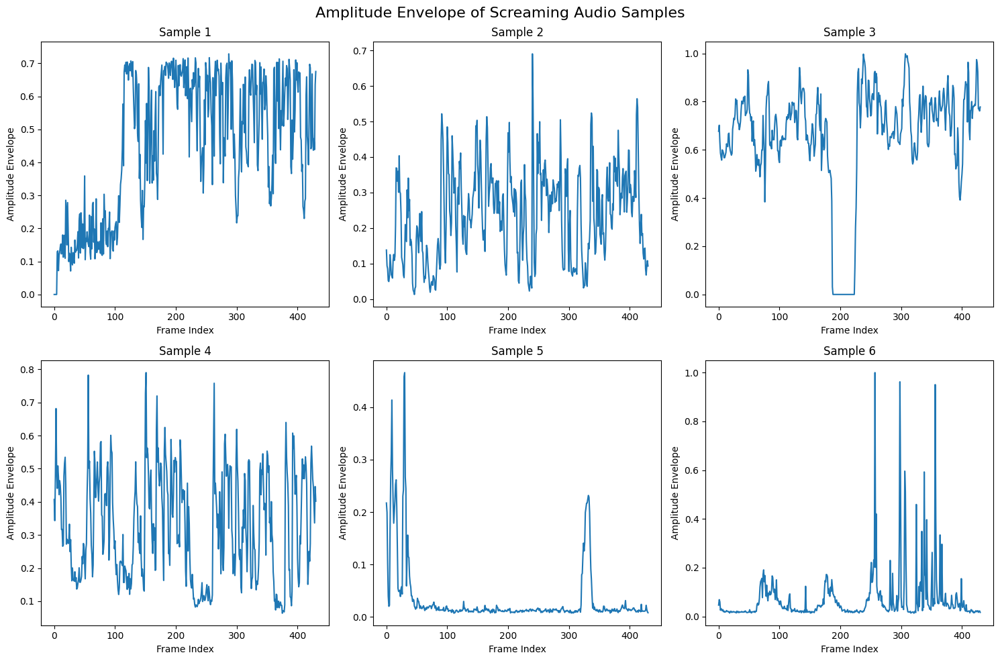

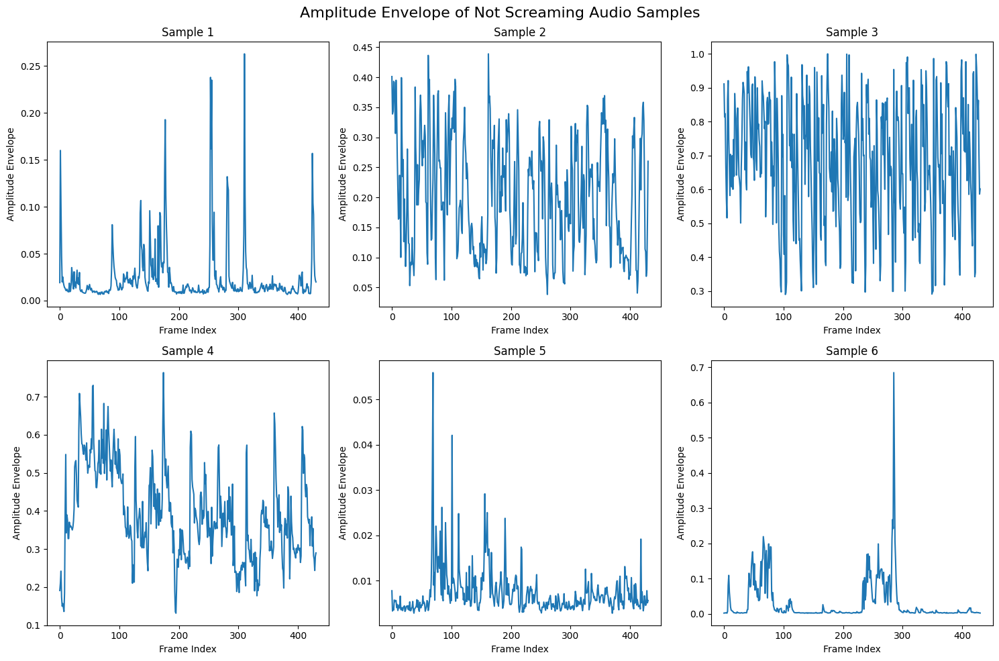

In [ ]:
# Define the AE (Amplitude Envelope) function
def AE(signal, frame_size):
    amplitude_envelope = []
    for i in range(0, len(signal), frame_size):
        frame = signal[i:i+frame_size]
        amplitude_envelope.append(np.max(np.abs(frame)))
    return amplitude_envelope
def plot_amplitude_envelope(audio_files, title, frame_size=1024, num_samples=6):
    num_rows = (num_samples + 2) // 3  # Calculate the number of rows needed
    fig, axes = plt.subplots(num_rows, 3, figsize=(15, 5*num_rows))
    fig.suptitle(title, fontsize=16)
    for i, ax in enumerate(axes.flat):
        if i < num_samples:
            amplitude_envelope = AE(audio_files[i], frame_size)
            ax.plot(amplitude_envelope)
            ax.set_title(f'Sample {i+1}')
            ax.set_xlabel('Frame Index')
            ax.set_ylabel('Amplitude Envelope')
        else:
            ax.axis('off')  # Hide empty subplot
    plt.tight_layout()
    plt.show()


plot_amplitude_envelope(screaming_files[:6], 'Amplitude Envelope of Screaming Audio Samples')
plot_amplitude_envelope(notscreaming_files[:6], 'Amplitude Envelope of Not Screaming Audio Samples')


### Root-Mean-Square Energy
As mentioned previously, the Root-Mean-Square (RMS) Energy is quite similar to the AE. As opposed to onset detection, however, it attempts to perceive loudness, which can be used for event detection. Furthermore, it is much more robust against outliers, meaning if we segment audio, we can detect new events (such a a new instrument, someone speaking, etc.) much more reliably.


Screaming RMS values (first 6 samples): [0.15695006, 0.08684352, 0.23391044, 0.13043454, 0.01223686, 0.021381458]
Not Screaming RMS values (first 6 samples): [0.0064205187, 0.07200087, 0.2529787, 0.14734444, 0.0022699968, 0.009152343]


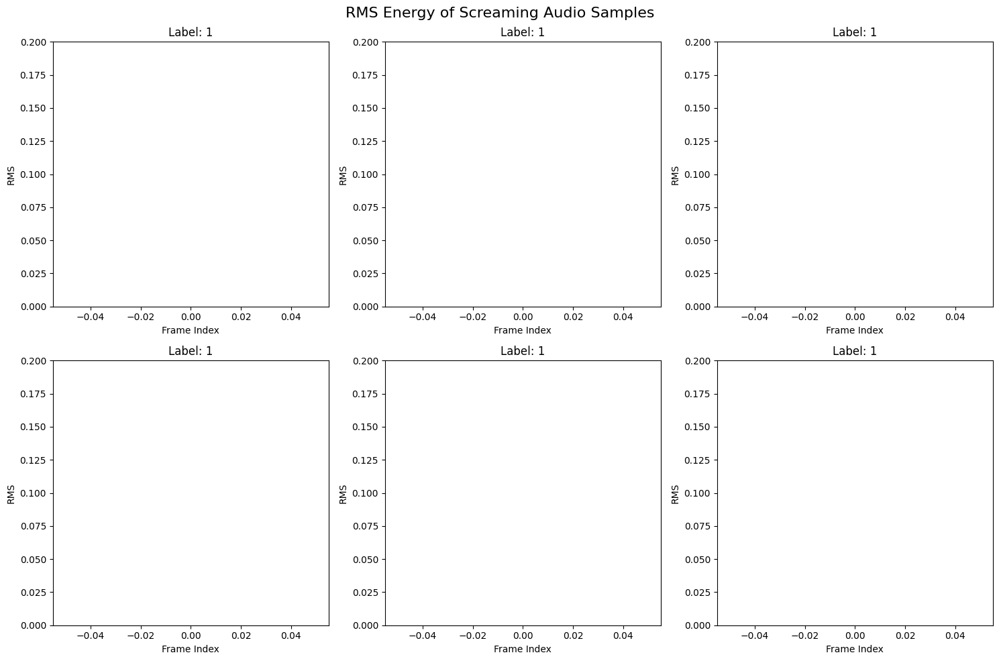

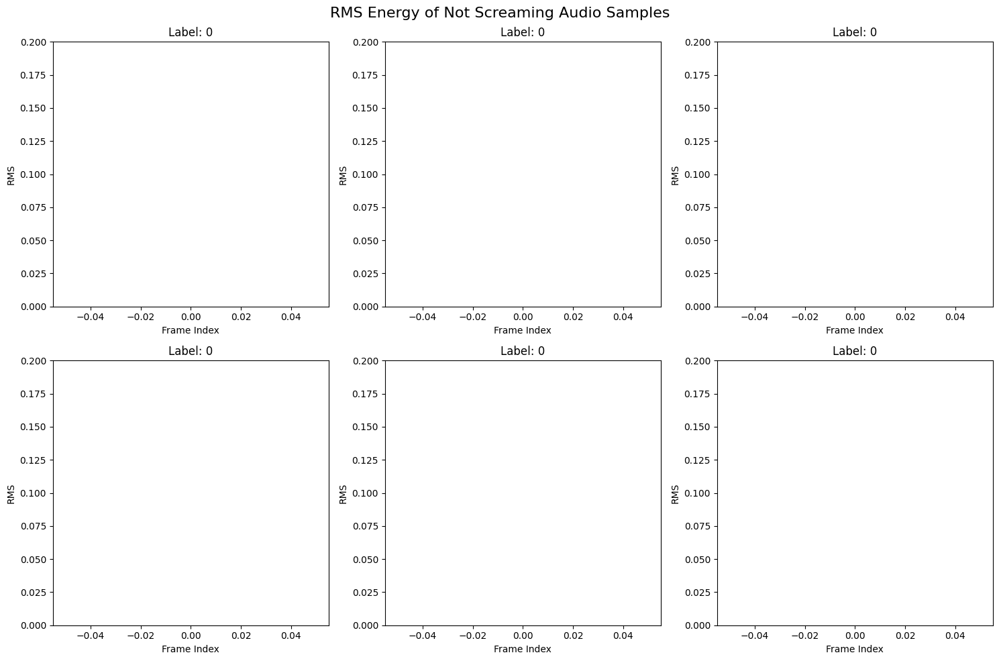

In [ ]:
# Function to plot RMS energy
def plot_rms(rms_values, labels, title, num_samples=6):
    num_rows = (num_samples + 2) // 3  # Calculate the number of rows needed
    fig, axes = plt.subplots(num_rows, 3, figsize=(15, 5*num_rows))
    fig.suptitle(title, fontsize=16)
    for i, ax in enumerate(axes.flat):
        if i < num_samples:
            ax.plot(rms_values[i])
            ax.set_ylim(0, 0.2)  # Set y-axis limits based on the range of provided RMS values
            ax.set_title(f'Label: {labels[i]}')
            ax.set_xlabel('Frame Index')
            ax.set_ylabel('RMS')
        else:
            ax.axis('off')  # Hide empty subplot
    plt.tight_layout()
    plt.show()

# Check RMS values
print("Screaming RMS values (first 6 samples):", screaming_rms[:6])
print("Not Screaming RMS values (first 6 samples):", notscreaming_rms[:6])

# Plot RMS energy for a few samples
plot_rms(screaming_rms[:6], screaming_labels[:6], 'RMS Energy of Screaming Audio Samples')
plot_rms(notscreaming_rms[:6], notscreaming_labels[:6], 'RMS Energy of Not Screaming Audio Samples')

### Zero-Crossing Rate
The Zero-Crossing Rate (ZCR) aims to study the the rate in which a signal’s amplitude changes sign within each frame. Compared to the previous two features, this one is quite simple to extract.

For MIR, this feature is relevant for identifying percussion sound as they often have fluctuating signals that can ZCR can detect quite well as well as pitch detection. However, this feature is generally used as a feature in speech recognition for voice activity detection.

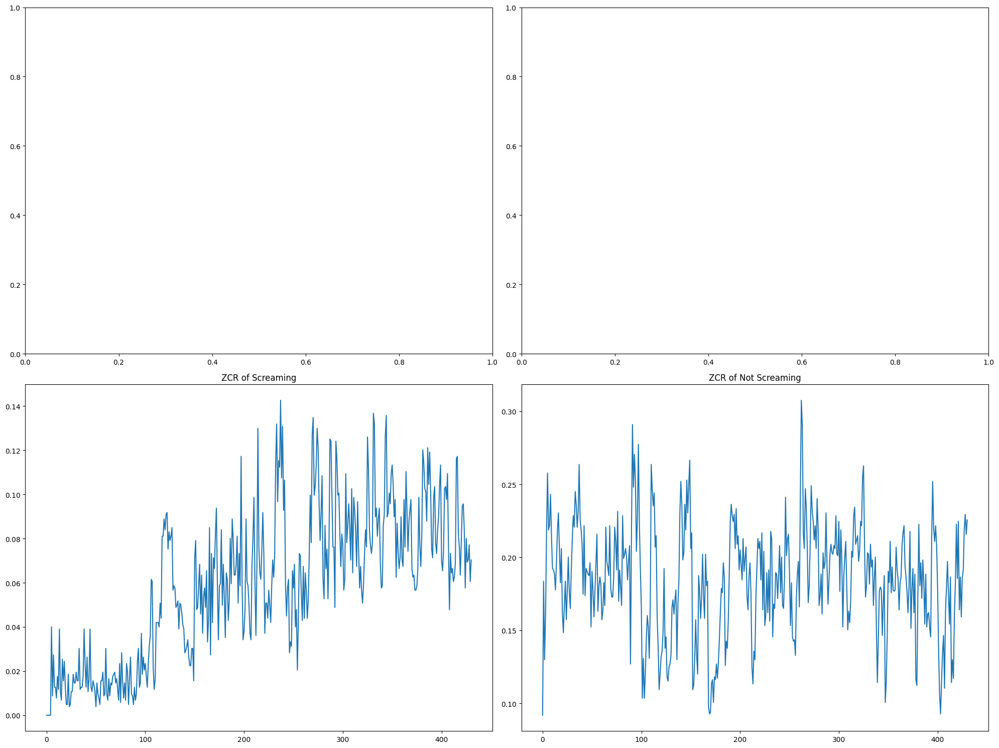

In [ ]:
import matplotlib.pyplot as plt
import librosa.display as lds

# Define ZCR for each dataset
zcr_screaming = librosa.feature.zero_crossing_rate(y=screaming_files[0], frame_length=1024, hop_length=1024)
zcr_not_screaming = librosa.feature.zero_crossing_rate(y=notscreaming_files[0], frame_length=1024, hop_length=1024)

fig, ax = plt.subplots(2, 2, figsize=(20, 15))

# Screaming
ax[1,0].set(title = 'ZCR of Screaming')
ax[1,0].plot(zcr_screaming.T)

# Not Screaming
ax[1,1].set(title = 'ZCR of Not Screaming')
ax[1,1].plot(zcr_not_screaming.T)

plt.tight_layout()
plt.show()


### Fourier Transformation
What is the Fourier Transformation? Why is it Important?
When looking at the figure above, we can see various spikes of amplitudes creating a unique pattern to the unique sound. This is because all complex sounds — like the sounds of our voices — are really just a sum of many sine and cosine signals.

It is important to note that by using this transformation, we will be translating the audio from the time-domain to the frequency-domain. Here are some key points about the two:

The time domain looks at the variation of the signal’s amplitude over time. This is useful for understanding its physical shape. In order to plot this, we need time on the x-axis and amplitude on the y-axis. The shape gives us a good idea of how loud or quiet the sound will be.
The frequency domain observes the constituent signals our recording is comprised of. By doing this, we can find a sort of “fingerprint” of the sound. In order to plot this, we need frequency on the x-axis and magnitude on the y-axis. The larger the magnitude, the more important that frequency is. The magnitude is simply the absolute value of our results from the FFT.

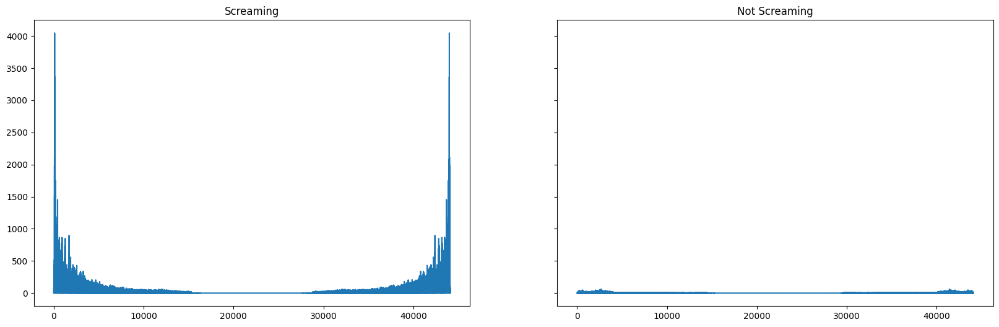

In [ ]:

import numpy as np

def fft_components(sound, sample_rate):
    # Find FFT
    fft = np.fft.fft(sound)

    # Find magnitude
    mag = np.abs(np.real(fft))

    # Find frequency
    freq = np.linspace(0, sample_rate, len(mag))

    return mag, freq

# Using function from above to find components
screaming_mag, screaming_freq = fft_components(screaming_files[0], screaming_sample_rates[0])
not_screaming_mag, not_screaming_freq = fft_components(notscreaming_files[0], notscreaming_sample_rates[0])

# Visualize the FFT
fig, ax = plt.subplots(1, 2, figsize=(20, 6), sharey=True)

ax[0].plot(screaming_freq, screaming_mag)
ax[0].set(title='Screaming')

ax[1].plot(not_screaming_freq, not_screaming_mag)
ax[1].set(title='Not Screaming')

plt.show()



#### The Mel Scale, Mel Spectrograms, and Mel Frequency Cepstral Coefficients

The main aim of this article is to introduce a new flavor of spectrograms — one that is widely used in the Machine Learning space as it represents human-like perception very well.

#### Mel Scale:
Before discussing Mel Spectrograms, we first need to understand what the Mel Scale is and why it is useful. The Mel Scale is a logarithmic transformation of a signal’s frequency. The core idea of this transformation is that sounds of equal distance on the Mel Scale are perceived to be of equal distance to humans. What does this mean?

For example, most human beings can easily tell the difference between a 100Hz and 200Hz sound. However, by that same token, we should assume that we can tell the difference between 1000Hz and 1100Hz, right? Wrong.

It is actually much harder for humans to be able to differentiate between higher frequencies, and easier for lower frequencies. So, even though the distance between the two sets of sounds are the same, our perception of the distance is not. This is what makes the Mel Scale fundamental in Machine Learning applications to audio, as it mimics our own perception of sound.

The transformation from the Hertz scale to the Mel Scale is the following:

m=1127*log(1+(f/700))

Note that log in this case refers to the natural logarithm (also denoted as ln.) If the logarithm were of base 10, the equation’s coefficient (1127) would alter slightly. However, in this article, we will simply refer to the equation stated above.


### Mel Spectrograms:
are spectrograms that visualize sounds on the Mel scale as opposed to the frequency domain.Mel Spectrograms offer advantages compared to regular spectrograms as they can take into account the human perception of sound. This is important when analyzing sound in the way it is perceived by humans, as our perceptions of sound vary depending on the frequency.
Additionally, Mel Spectrograms are useful for applications that require sound representation in a form that corresponds to human perception, such as speech recognition, music recognition, and emotion detection from sound .Finally, it should be noted that the choice of the appropriate type of spectrogram depends on the type of application and its goals. However, Mel Spectrograms are a powerful tool for sound representation in a way that corresponds to human perception, and therefore are often used.
Mel Spectrograms work well for most audio deep learning applications. However, for problems dealing with human speech, like Automatic Speech Recognition, you might find that MFCC (Mel Frequency Cepstral Coefficients) sometimes work better.
These essentially take Mel Spectrograms and apply a couple of further processing steps. This selects a compressed representation of the frequency bands from the Mel Spectrogram that correspond to the most common frequencies at which humans speak.
Mel Spectrograms work well for most audio deep learning applications. However, for problems dealing with human speech, like Automatic Speech Recognition, you might find that MFCC (Mel Frequency Cepstral Coefficients) sometimes work better.
These essentially take Mel Spectrograms and apply a couple of further processing steps. This selects a compressed representation of the frequency bands from the Mel Spectrogram that correspond to the most common frequencies at which humans speak.







In [ ]:
import numpy as np
import plotly.graph_objects as go

# Define the function for converting from Hz to Mel
def freq_to_mel(f):
   return 1127 * np.log(1 + (f / 700))

# Vector of frequencies in Hz, from 20 Hz to 20 kHz
Hz = np.linspace(20, 20000)

# Apply the conversion function to each element of the Hz vector
Mel = freq_to_mel(Hz)

# Create a plotly figure
fig = go.Figure()

# Add a scatter plot for the conversion
fig.add_trace(go.Scatter(x=Hz, y=Mel, mode='lines', name='Hertz to Mel'))

# Update layout
fig.update_layout(title='Hertz to Mel',
                  xaxis_title='Hertz Scale',
                  yaxis_title='Mel Scale')

# Show plot
fig.show()

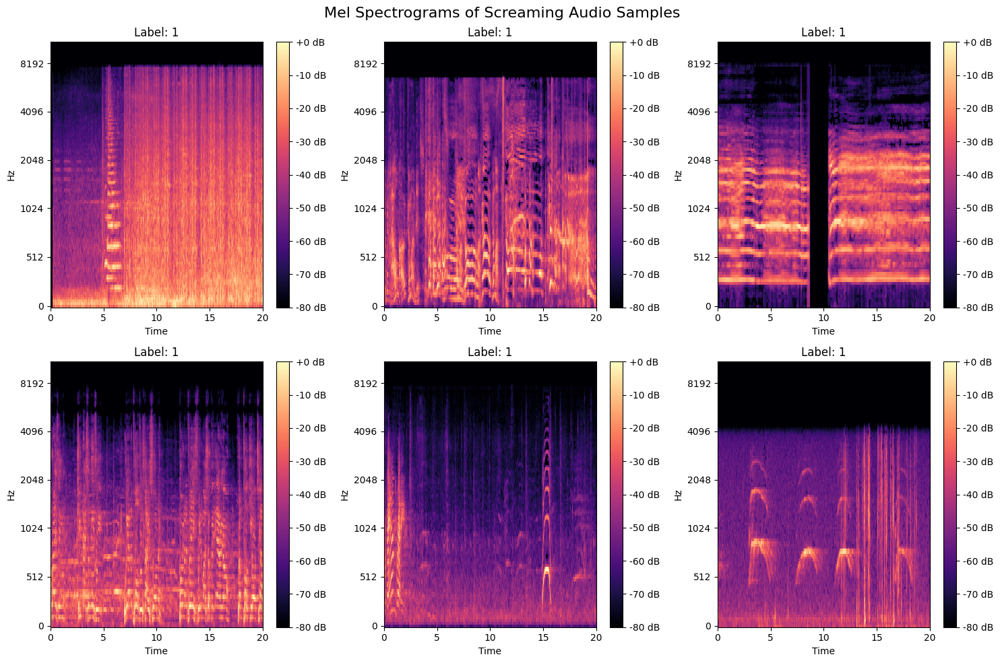

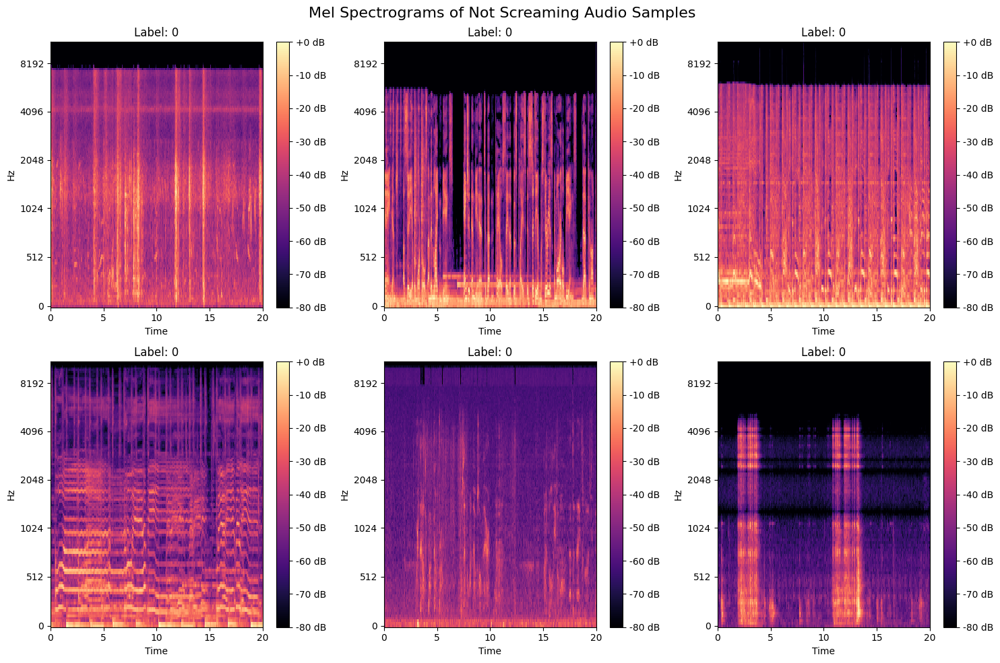

In [ ]:
def plot_mel_spectrograms(audio_files, labels, title, num_samples=6):
    num_rows = (num_samples + 2) // 3  # Calculate the number of rows needed
    fig, axes = plt.subplots(num_rows, 3, figsize=(15, 5*num_rows))
    fig.suptitle(title, fontsize=16)
    for i, ax in enumerate(axes.flat):
        if i < num_samples:
            S = librosa.feature.melspectrogram(y=audio_files[i], sr=22050, n_mels=128)
            S_dB = librosa.power_to_db(S, ref=np.max)
            img = librosa.display.specshow(S_dB, sr=22050, x_axis='time', y_axis='mel', ax=ax)
            ax.set_title(f'Label: {labels[i]}')
            fig.colorbar(img, ax=ax, format="%+2.0f dB")
        else:
            ax.axis('off')  # Hide empty subplot
    plt.tight_layout()
    plt.show()

plot_mel_spectrograms(screaming_files[:6], screaming_labels[:6], 'Mel Spectrograms of Screaming Audio Samples')
plot_mel_spectrograms(notscreaming_files[:6], notscreaming_labels[:6], 'Mel Spectrograms of Not Screaming Audio Samples')



#### Mel Frequency Cepstral Coefficients:
Mel Frequency Cepstral Coefficients (MFCCs) were originally used in various speech processing techniques, however, as the field of Music Information Retrieval (MIR) began to develop further adjunct to Machine Learning, it was found that MFCCs could represent timbre quite well.

The basic procedure to develop MFCCs is the following:

1.Convert from Hertz to Mel Scale  

2.Take logarithm of Mel representation of audio

3.Take logarithmic magnitude and use Discrete Cosine Transformation

4.This result creates a spectrum over Mel frequencies as opposed to time, thus creating MFCCs


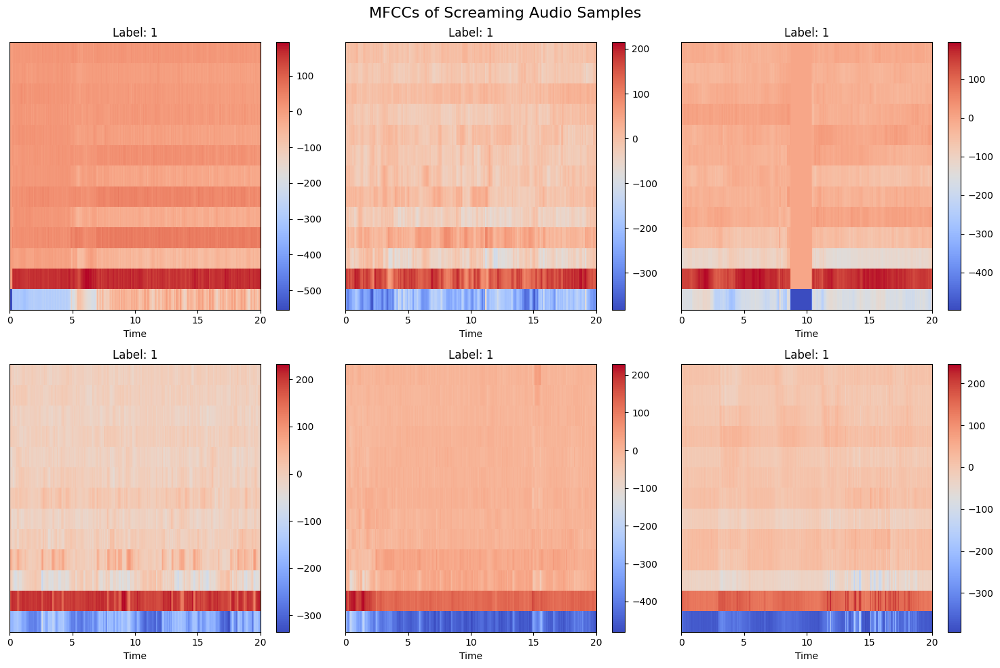

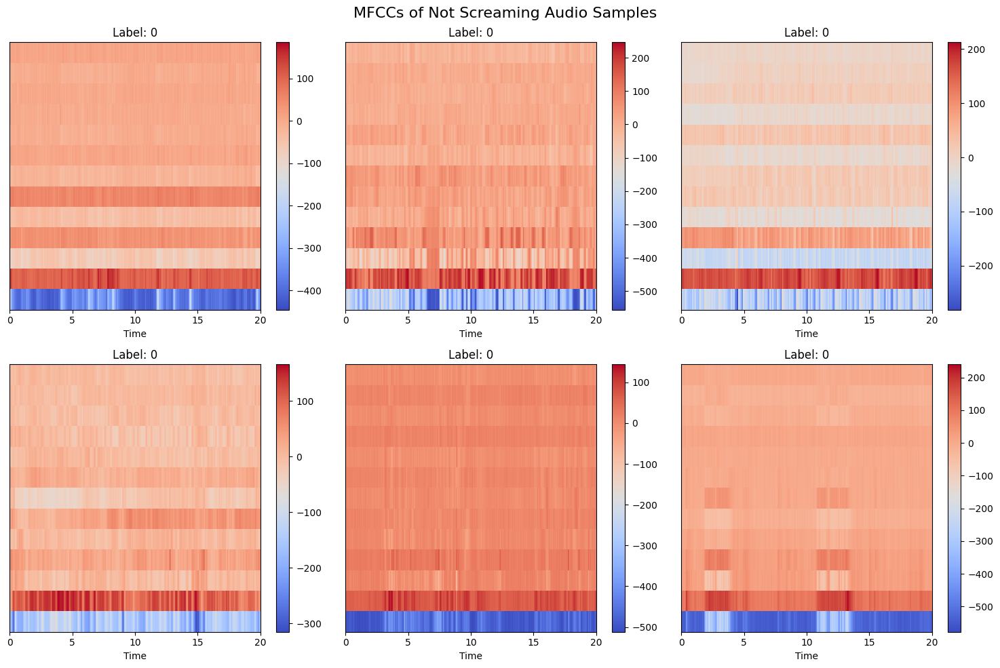

In [ ]:
def plot_mfccs(audio_files, labels, title, num_samples=6):
    num_rows = (num_samples + 2) // 3  # Calculate the number of rows needed
    fig, axes = plt.subplots(num_rows, 3, figsize=(15, 5*num_rows))
    fig.suptitle(title, fontsize=16)
    for i, ax in enumerate(axes.flat):
        if i < num_samples:
            mfccs = librosa.feature.mfcc(y=audio_files[i], sr=22050, n_mfcc=13)
            img = librosa.display.specshow(mfccs, sr=22050, x_axis='time', ax=ax)
            ax.set_title(f'Label: {labels[i]}')
            fig.colorbar(img, ax=ax)
        else:
            ax.axis('off')  # Hide empty subplot
    plt.tight_layout()
    plt.show()

plot_mfccs(screaming_files[:6], screaming_labels[:6], 'MFCCs of Screaming Audio Samples')
plot_mfccs(notscreaming_files[:6], notscreaming_labels[:6], 'MFCCs of Not Screaming Audio Samples')


### Chroma filter bank

In the context of a human scream detection project, the chroma filter bank can prove useful for detecting certain tonal characteristics associated with screams, especially if screams exhibit specific pitch patterns or tonal qualities that distinguish them from other sounds in the background. For example, screams might have higher energy in certain pitch classes compared to other types of vocalizations or environmental sounds.


#### Chromagram

In a scream detection project, chroma features might be helpful in capturing certain tonal characteristics associated with screams, especially if the screams exhibit specific pitch patterns or tonal qualities that distinguish them from other sounds in the background. For example, screams might tend to have higher energy in certain pitch classes compared to other types of vocalizations or environmental sounds.

However, it's essential to consider that chroma features alone may not be sufficient for scream detection, especially in complex audio environments with background noise or overlapping sounds. You may need to combine chroma features with other types of features, such as spectral features or temporal features, and use machine learning techniques to effectively classify screams from other sounds.

Ultimately, the suitability of using chroma features in your scream detection project depends on the characteristics of your dataset and the specific requirements of your application. It's worth experimenting with different feature representations and evaluating their performance to determine the most effective approach for your project.

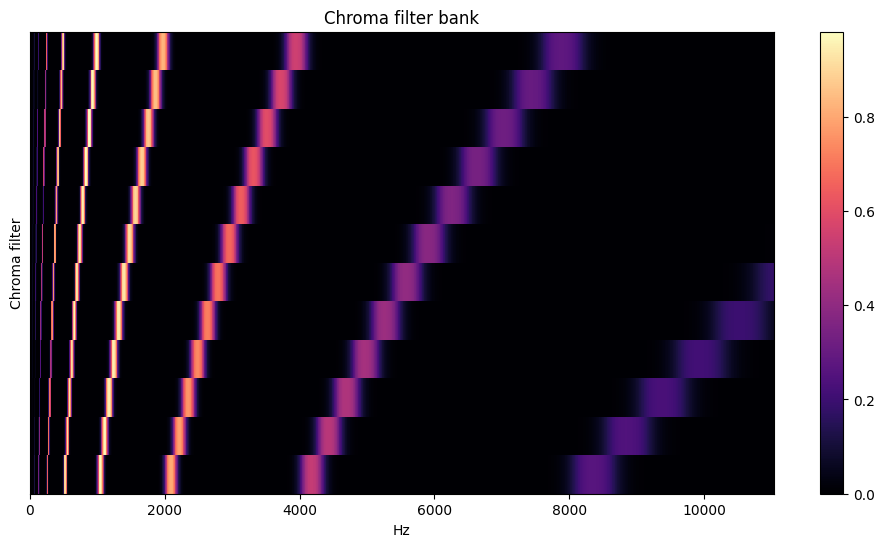

In [ ]:

import librosa
import librosa.display
import matplotlib.pyplot as plt


scream_audio, sampling_rate = librosa.load('/content/drive/My Drive/DeepLearning/code/dataset/Screaming/0-RnTXpp8Q0_out.wav')

# Adjust these parameters based on your project
n_chroma = 12  # Number of chroma bins
n_fft = 2048   # Number of FFT bins, typically half of the frame size

# Generate the chroma filter bank
chromafb = librosa.filters.chroma(sr=sampling_rate, n_fft=n_fft, n_chroma=n_chroma)

# Plot the chroma filter bank
fig, ax = plt.subplots(figsize=(12, 6))
img = librosa.display.specshow(chromafb, x_axis='linear', ax=ax)
ax.set(ylabel='Chroma filter', title='Chroma filter bank')
fig.colorbar(img, ax=ax)
plt.show()


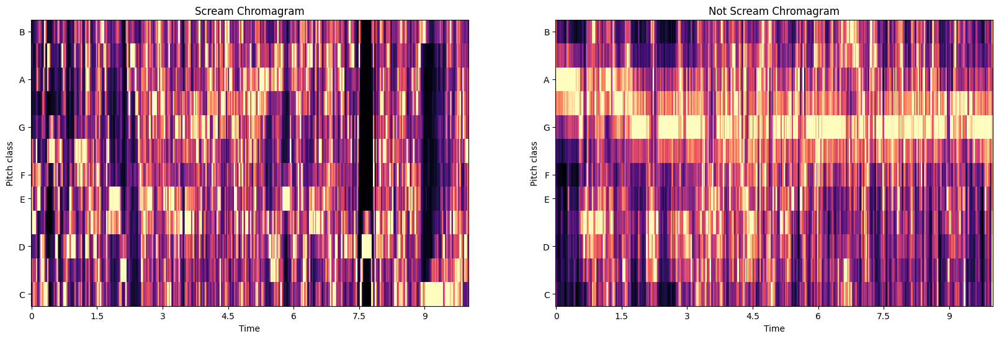

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt

# Load the scream and not scream audio files
scream_audio, scream_sample_rate = librosa.load('/content/drive/My Drive/DeepLearning/code/dataset/Screaming/0-RnTXpp8Q0_out.wav')
not_scream_audio, not_scream_sample_rate = librosa.load('/content/drive/My Drive/DeepLearning/code/dataset/NotScreaming/MGvjQbBNEE0_out.wav')

# Create chromagrams for scream and not scream
scream_chroma = librosa.feature.chroma_stft(y=scream_audio, sr=scream_sample_rate)
not_scream_chroma = librosa.feature.chroma_stft(y=not_scream_audio, sr=not_scream_sample_rate)

# Visualize the chromagrams
fig, ax = plt.subplots(1, 2, figsize=(20, 6))

librosa.display.specshow(scream_chroma, y_axis='chroma', x_axis='time', ax=ax[0])
ax[0].set(title='Scream Chromagram')

librosa.display.specshow(not_scream_chroma, y_axis='chroma', x_axis='time', ax=ax[1])
ax[1].set(title='Not Scream Chromagram')

plt.show()


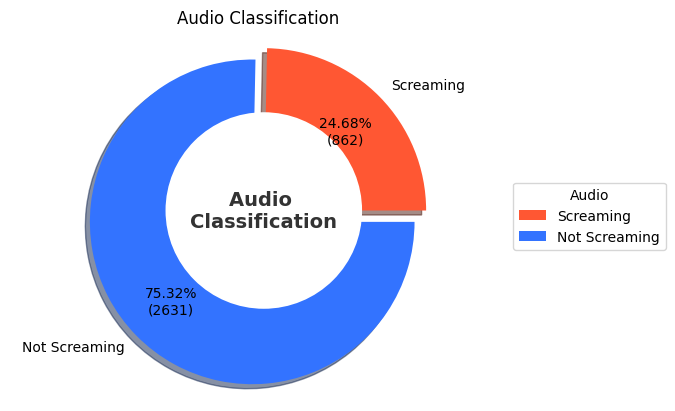

In [ ]:
# Assuming audio_files, screaming_files, and notscreaming_files are defined elsewhere in your code

# Count total number of audio files
total_files = len(screaming_files+notscreaming_files)

# Calculate percentages
screaming_percentage = (len(screaming_files) / total_files) * 100
notscreaming_percentage = (len(notscreaming_files) / total_files) * 100

unique_emotion = ["Screaming", "Not Screaming"]
colors = ['#FF5733', '#3373FF']

# Plotting the pie chart
fig, ax = plt.subplots()

wedges, texts, autotexts = ax.pie(
    x=[len(screaming_files), len(notscreaming_files)],
    labels=unique_emotion,
    autopct=lambda p: f'{p:.2f}%\n({int(p*total_files/100)})',
    wedgeprops=dict(width=0.7),
    textprops=dict(size=10, color="black"),
    pctdistance=0.7,
    colors=colors,
    explode=[0, 0.1],  # Explode the "Not Screaming" slice for emphasis
    shadow=True
)

# Add a white circle in the middle for better aesthetics
center_circle = plt.Circle((0, 0), 0.6, color='white', fc='white', linewidth=1.25)
fig.gca().add_artist(center_circle)

# Add a title and legend
ax.text(0, 0, 'Audio \nClassification', ha='center', va='center', fontsize=14, fontweight='bold', color='#333333')
ax.legend(unique_emotion, title="Audio", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))

ax.axis('equal')
plt.title('Audio Classification')

# Display the pie chart
plt.show()



### Comments based on Pie Chart

The "not screaming" category appears to comprise the largest portion of the samples in our dataset, with approximately 75.31%. Conversely, the "screaming" category seems to represent the smallest portion of the samples, with approximately 24.68%. This results in having an **imbalanced dataset**.

In [ ]:
import plotly.express as px

# Plot a histogram for the distribution of durations using Plotly
fig = px.histogram(audio_data_df, x='Duration', nbins=30, marginal='rug', title='Distribution of Audio File Durations')
fig.update_layout(xaxis_title='Duration (seconds)', yaxis_title='Frequency')
fig.show()


In [ ]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define features
features = ['Max Amplitude', 'ZCR', 'Mel Spectrogram', 'Spectral Centroid', 'Spectral Bandwidth', 'Spectral Rolloff', 'Spectral Flux', 'Spectral Contrast', 'Spectral Flatness', 'RMS', 'Energy']

# Create subplots with 1 row and 2 columns
fig = make_subplots(rows=1, cols=2, subplot_titles=('Screaming', 'Not Screaming'))

# Add traces for each feature
for i, feature in enumerate(features):
    # Create histograms for screaming and not screaming data
    screaming_hist = go.Histogram(x=screaming_df[feature], name=f'Screaming - {feature}', opacity=0.7, visible=(i == 0))
    notscreaming_hist = go.Histogram(x=notscreaming_df[feature], name=f'Not Screaming - {feature}', opacity=0.7, visible=(i == 0))

    # Add histograms to subplots
    fig.add_trace(screaming_hist, row=1, col=1)
    fig.add_trace(notscreaming_hist, row=1, col=2)

# Create dropdown buttons
buttons = []
for i, feature in enumerate(features):
    visible = [False] * len(features) * 2
    visible[i * 2] = True
    visible[i * 2 + 1] = True
    buttons.append(dict(label=feature, method='update', args=[{'visible': visible}]))

# Update layout with dropdown menu
fig.update_layout(
    updatemenus=[dict(type='dropdown', showactive=True, buttons=buttons)],
    title_text='Feature Comparison for Screaming and Not Screaming',
    xaxis_title='Value',
    yaxis_title='Frequency'
)

# Show plot
fig.show()


In [ ]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define features
features = ['Max Amplitude', 'ZCR', 'Mel Spectrogram', 'Spectral Centroid', 'Spectral Bandwidth', 'Spectral Rolloff', 'Spectral Flux', 'Spectral Contrast', 'Spectral Flatness', 'RMS', 'Energy']

# Create subplots with 1 row and 2 columns
fig = make_subplots(rows=1, cols=2, subplot_titles=('Screaming', 'Not Screaming'))

# Add traces for each feature
for i, feature in enumerate(features):
    # Create box plots for screaming and not screaming data
    screaming_box = go.Box(y=screaming_df[feature], name=f'Screaming - {feature}', visible=(i == 0))
    notscreaming_box = go.Box(y=notscreaming_df[feature], name=f'Not Screaming - {feature}', visible=(i == 0))

    # Add box plots to subplots
    fig.add_trace(screaming_box, row=1, col=1)
    fig.add_trace(notscreaming_box, row=1, col=2)

# Create dropdown buttons
buttons = []
for i, feature in enumerate(features):
    visible = [False] * len(features) * 2
    visible[i * 2] = True
    visible[i * 2 + 1] = True
    buttons.append(dict(label=feature, method='update', args=[{'visible': visible}]))

# Update layout with dropdown menu
fig.update_layout(
    updatemenus=[dict(type='dropdown', showactive=True, buttons=buttons, x=0.5, xanchor='center', y=1.1, yanchor='top')],
    title_text='Feature Comparison for Screaming and Not Screaming',
    yaxis_title='Value',
    xaxis_title='Feature'
)

# Show plot
fig.show()

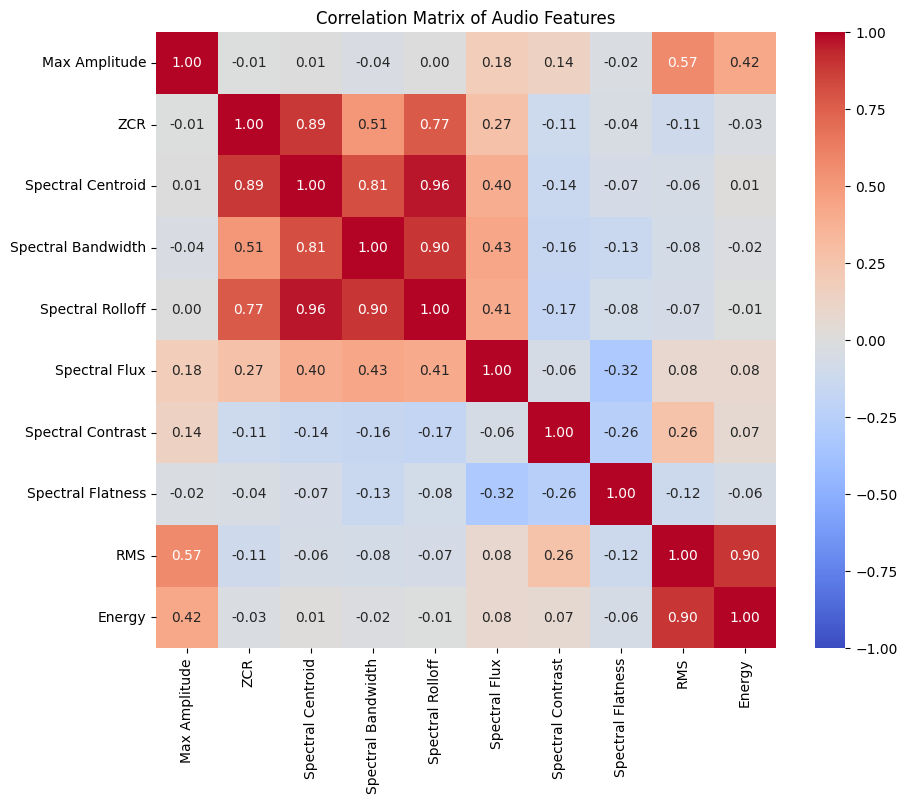

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Extracting features into a DataFrame
feature_data = audio_data_df[['Max Amplitude', 'ZCR', 'Spectral Centroid',
                              'Spectral Bandwidth','Spectral Rolloff', 'Spectral Flux', 'Spectral Contrast', 'Spectral Flatness', 'RMS', 'Energy']]

# Calculating the correlation matrix
corr_matrix = feature_data.corr()

# Plotting the correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Matrix of Audio Features')
plt.show()